# Merge Train and Test Data

In [1]:
import os
import shutil

# مسارات المجلدات
train_folder_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train"
test_folder_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Test"
merged_folder_path = "/kaggle/working/Merged_Data"  # مسار مجلد الدمج

# إنشاء مجلد الدمج إذا لم يكن موجودًا
os.makedirs(merged_folder_path, exist_ok=True)

# الحصول على قائمة الكلاسات
classes = [f.name for f in os.scandir(train_folder_path) if f.is_dir()]

# دمج الصور لكل كلاس
for class_name in classes:
    # مسارات فولدر الكلاس في train و test
    train_class_path = os.path.join(train_folder_path, class_name)
    test_class_path = os.path.join(test_folder_path, class_name)

    # إنشاء فولدر الكلاس في مجلد الدمج
    merged_class_path = os.path.join(merged_folder_path, class_name)
    os.makedirs(merged_class_path, exist_ok=True)

    # نسخ الصور من train
    for image_file in os.listdir(train_class_path):
        if image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
            shutil.copy(os.path.join(train_class_path, image_file), merged_class_path)

    # نسخ الصور من test
    for image_file in os.listdir(test_class_path):
        if image_file.lower().endswith(('.png', '.jpg', '.jpeg')):
            shutil.copy(os.path.join(test_class_path, image_file), merged_class_path)

print("تم دمج الصور بنجاح!")


تم دمج الصور بنجاح!


# Augmentation

In [2]:
import cv2
import numpy as np
import os
import glob
from collections import defaultdict

# 🔹 **دوال التحسينات**
def flip_augmentations(img):
    """Apply 3 different flips (excluding the original)."""
    return {
        "flip_horizontal": cv2.flip(img, 1),  # Flip left-right
        "flip_vertical": cv2.flip(img, 0),  # Flip up-down
        "flip_both": cv2.flip(img, -1),  # Flip both axes
    }

def rotate_augmentations(img):
    """Apply 3 different rotations."""
    return {
        "rotate_90_CW": cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE),
        "rotate_90_CCW": cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE),
        "rotate_180": cv2.rotate(img, cv2.ROTATE_180),
    }

# 🔹 **المجلد الرئيسي للصور الأصلية والمعدلة**
root_folder = "/kaggle/working/Merged_Data"

# 🔹 **جلب جميع الصور من المجلدات الفرعية وتصنيفها حسب الفئات**
image_paths = glob.glob(os.path.join(root_folder, "**", "*.jpg"), recursive=True)

# 🔹 **تصنيف الصور داخل كل كلاس**
class_images = defaultdict(list)
for image_path in image_paths:
    class_name = os.path.basename(os.path.dirname(image_path))  # اسم الفولدر (الكلاس)
    class_images[class_name].append(image_path)

# 🔹 **تحديد الحد الأقصى لكل كلاس**
MAX_IMAGES_PER_CLASS = 600

# 🔹 **تطبيق التحسينات مع الحفظ داخل نفس المسار**
for class_name, images in class_images.items():
    num_original = len(images)
    
    # تحديد المجلد الجديد للكلاس (نفس المجلد الأصلي)
    save_class_folder = os.path.join(root_folder, class_name)
    os.makedirs(save_class_folder, exist_ok=True)

    print(f"🔹 الكلاس: {class_name} - الصور الأصلية: {num_original}")

    if num_original >= MAX_IMAGES_PER_CLASS:
        print(f"✅ لا حاجة للتحسينات، عدد الصور في {class_name} كافٍ ({num_original})")
        continue  # تخطي هذا الكلاس إذا كان يحتوي بالفعل على الحد المطلوب

    # 🔹 **توليد صور Augmentation حتى يصل العدد إلى الحد المطلوب**
    needed_images = MAX_IMAGES_PER_CLASS - num_original
    generated_count = 0

    for image_path in images:
        if generated_count >= needed_images:
            break  # إذا وصلنا إلى العدد المطلوب، نخرج من اللوب

        img = cv2.imread(image_path)
        if img is None:
            continue

        # تطبيق التحسينات
        augmentations = {**flip_augmentations(img), **rotate_augmentations(img)}

        for aug_type, aug_img in augmentations.items():
            if generated_count >= needed_images:
                break

            # توليد اسم جديد مع تجنب استبدال الملفات الأصلية
            save_filename = f"{os.path.splitext(os.path.basename(image_path))[0]}_{aug_type}.jpg"
            save_filepath = os.path.join(save_class_folder, save_filename)

            # حفظ الصورة الجديدة في نفس مجلد الصورة الأصلية
            cv2.imwrite(save_filepath, aug_img)
            generated_count += 1

    print(f"✅ تم إنشاء {generated_count} صورة جديدة في {class_name}, ليصبح الإجمالي {min(MAX_IMAGES_PER_CLASS, num_original + generated_count)} صورة.")

print(f"\n🎯 تم حفظ جميع الصور بعد التحسينات داخل نفس مجلد الصور الأصلية!")


🔹 الكلاس: vascular lesion - الصور الأصلية: 142
✅ تم إنشاء 458 صورة جديدة في vascular lesion, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: squamous cell carcinoma - الصور الأصلية: 197
✅ تم إنشاء 403 صورة جديدة في squamous cell carcinoma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: basal cell carcinoma - الصور الأصلية: 392
✅ تم إنشاء 208 صورة جديدة في basal cell carcinoma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: dermatofibroma - الصور الأصلية: 111
✅ تم إنشاء 489 صورة جديدة في dermatofibroma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: melanoma - الصور الأصلية: 454
✅ تم إنشاء 146 صورة جديدة في melanoma, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: pigmented benign keratosis - الصور الأصلية: 478
✅ تم إنشاء 122 صورة جديدة في pigmented benign keratosis, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: nevus - الصور الأصلية: 373
✅ تم إنشاء 227 صورة جديدة في nevus, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: actinic keratosis - الصور الأصلية: 130
✅ تم إنشاء 470 صورة جديدة في actinic keratosis, ليصبح الإجمالي 600 صورة.
🔹 الكلاس: seborrheic keratosis - الصور ا

# print number of images at each class

In [3]:
import os

# مسار المجلد الرئيسي
main_folder_path = "/kaggle/working/Merged_Data"

# الحصول على قائمة الفولدرات (الكلاسات)
folders = [f.name for f in os.scandir(main_folder_path) if f.is_dir()]

# طباعة عدد الصور في كل فولدر
print("عدد الصور داخل كل كلاس:")
for folder_name in folders:
    folder_path = os.path.join(main_folder_path, folder_name)
    # عد جميع الملفات التي لها امتداد صورة شائع
    image_files = [f for f in os.listdir(folder_path) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
    print(f"{folder_name}: {len(image_files)} صورة")


عدد الصور داخل كل كلاس:
vascular lesion: 600 صورة
squamous cell carcinoma: 600 صورة
basal cell carcinoma: 600 صورة
dermatofibroma: 600 صورة
melanoma: 600 صورة
pigmented benign keratosis: 600 صورة
nevus: 600 صورة
actinic keratosis: 600 صورة
seborrheic keratosis: 560 صورة


# Models without processing

In [4]:
from tensorflow.keras.applications import VGG16
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

# تحميل بيانات الصور
data_dir = "/kaggle/working/Merged_Data"
img_size = (224, 224)
batch_size = 32

datagen = ImageDataGenerator(validation_split=0.2, rescale=1./255)
train_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='training')
val_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='validation')

# تحميل VGG16 بدون الطبقات العلوية
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
for layer in base_model.layers:
    layer.trainable = False  # تجميد الطبقات الأساسية

# إضافة طبقات مخصصة
x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(train_gen.num_classes, activation='softmax')(x)

# بناء النموذج النهائي
model_vgg16 = Model(inputs=base_model.input, outputs=x)

# تجميع النموذج
model_vgg16.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

# تدريب النموذج
model_vgg16.fit(train_gen, validation_data=val_gen, epochs=10)

# حفظ النموذج
# model_vgg16.save("/kaggle/working/vgg16_model.h5")


Found 4288 images belonging to 9 classes.
Found 1072 images belonging to 9 classes.
58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/10


/usr/local/lib/python3.10/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


134/134 ━━━━━━━━━━━━━━━━━━━━ 57s 338ms/step - accuracy: 0.2009 - loss: 2.1938 - val_accuracy: 0.2929 - val_loss: 1.8936
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 294ms/step - accuracy: 0.3465 - loss: 1.8262 - val_accuracy: 0.3675 - val_loss: 1.7711
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 301ms/step - accuracy: 0.3839 - loss: 1.7265 - val_accuracy: 0.4002 - val_loss: 1.7116
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 293ms/step - accuracy: 0.4372 - loss: 1.6171 - val_accuracy: 0.4347 - val_loss: 1.6568
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 293ms/step - accuracy: 0.4706 - loss: 1.5031 - val_accuracy: 0.3974 - val_loss: 1.6048
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 289ms/step - accuracy: 0.4808 - loss: 1.4501 - val_accuracy: 0.3843 - val_loss: 1.5957
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 287ms/step - accuracy: 0.5264 - loss: 1.3795 - val_accuracy: 0.4664 - val_loss: 1.5668
Epoch 8/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 289ms/step - accuracy: 0.5432 - loss: 1.3094 - val

In [5]:
from tensorflow.keras.applications import VGG19
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

# تحميل بيانات الصور
data_dir = "/kaggle/working/Merged_Data"
img_size = (224, 224)
batch_size = 32

datagen = ImageDataGenerator(validation_split=0.2, rescale=1./255)
train_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='training')
val_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='validation')

# تحميل VGG16 بدون الطبقات العلوية
base_model = VGG19(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
for layer in base_model.layers:
    layer.trainable = False  # تجميد الطبقات الأساسية

# إضافة طبقات مخصصة
x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(train_gen.num_classes, activation='softmax')(x)

model_vgg19 = Model(inputs=base_model.input, outputs=x)
model_vgg19.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
model_vgg19.fit(train_gen, validation_data=val_gen, epochs=10)
# حفظ النموذج
# model_vgg16.save("/kaggle/working/vgg16_model.h5")

Found 4288 images belonging to 9 classes.
Found 1072 images belonging to 9 classes.
80134624/80134624 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 45s 311ms/step - accuracy: 0.1621 - loss: 2.2970 - val_accuracy: 0.2948 - val_loss: 2.0028
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 39s 284ms/step - accuracy: 0.2780 - loss: 1.9837 - val_accuracy: 0.3116 - val_loss: 1.9228
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 288ms/step - accuracy: 0.3136 - loss: 1.8882 - val_accuracy: 0.3209 - val_loss: 1.8681
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 291ms/step - accuracy: 0.3514 - loss: 1.7983 - val_accuracy: 0.3731 - val_loss: 1.7636
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 296ms/step - accuracy: 0.3943 - loss: 1.7139 - val_accuracy: 0.4366 - val_loss: 1.7208
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 294ms/step - accuracy: 0.3956 - loss: 1.6554 - val_accuracy: 0.4002 - val_loss: 1.6846
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 290ms/step - accuracy: 0.4321 - los

In [6]:
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

# تحميل بيانات الصور
data_dir = "/kaggle/working/Merged_Data"
img_size = (224, 224)
batch_size = 32

datagen = ImageDataGenerator(validation_split=0.2, rescale=1./255)
train_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='training')
val_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='validation')

# تحميل VGG16 بدون الطبقات العلوية
base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
for layer in base_model.layers:
    layer.trainable = False  # تجميد الطبقات الأساسية

# إضافة طبقات مخصصة
x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(train_gen.num_classes, activation='softmax')(x)

model_mobilenet = Model(inputs=base_model.input, outputs=x)
model_mobilenet.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
model_mobilenet.fit(train_gen, validation_data=val_gen, epochs=10)
# حفظ النموذج
# model_vgg16.save("/kaggle/working/vgg16_model.h5")

Found 4288 images belonging to 9 classes.
Found 1072 images belonging to 9 classes.
17225924/17225924 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 48s 313ms/step - accuracy: 0.2921 - loss: 2.3922 - val_accuracy: 0.4580 - val_loss: 1.6470
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 39s 283ms/step - accuracy: 0.5717 - loss: 1.1943 - val_accuracy: 0.4785 - val_loss: 1.5042
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 285ms/step - accuracy: 0.6900 - loss: 0.8702 - val_accuracy: 0.4720 - val_loss: 1.5271
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 296ms/step - accuracy: 0.7858 - loss: 0.6319 - val_accuracy: 0.4692 - val_loss: 1.6042
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 39s 284ms/step - accuracy: 0.8276 - loss: 0.4875 - val_accuracy: 0.4860 - val_loss: 1.5691
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 39s 282ms/step - accuracy: 0.8620 - loss: 0.4047 - val_accuracy: 0.4823 - val_loss: 1.6815
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 287ms/step - accuracy: 0.8714 - los

In [7]:
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

# تحميل بيانات الصور
data_dir = "/kaggle/working/Merged_Data"
img_size = (224, 224)
batch_size = 32

datagen = ImageDataGenerator(validation_split=0.2, rescale=1./255)
train_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='training')
val_gen = datagen.flow_from_directory(data_dir, target_size=img_size, batch_size=batch_size, class_mode='categorical', subset='validation')

# تحميل VGG16 بدون الطبقات العلوية
base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
for layer in base_model.layers:
    layer.trainable = False  # تجميد الطبقات الأساسية

# إضافة طبقات مخصصة
x = Flatten()(base_model.output)
x = Dense(256, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(train_gen.num_classes, activation='softmax')(x)

model_densenet = Model(inputs=base_model.input, outputs=x)
model_densenet.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
model_densenet.fit(train_gen, validation_data=val_gen, epochs=10)
# حفظ النموذج
# model_vgg16.save("/kaggle/working/vgg16_model.h5")

Found 4288 images belonging to 9 classes.
Found 1072 images belonging to 9 classes.
29084464/29084464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 77s 410ms/step - accuracy: 0.3023 - loss: 2.1432 - val_accuracy: 0.4552 - val_loss: 1.5955
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 290ms/step - accuracy: 0.5214 - loss: 1.3167 - val_accuracy: 0.4515 - val_loss: 1.5680
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 291ms/step - accuracy: 0.6082 - loss: 1.0555 - val_accuracy: 0.4478 - val_loss: 1.6446
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 291ms/step - accuracy: 0.6806 - loss: 0.8649 - val_accuracy: 0.4804 - val_loss: 1.5966
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 40s 290ms/step - accuracy: 0.7515 - loss: 0.7138 - val_accuracy: 0.4813 - val_loss: 1.5603
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 294ms/step - accuracy: 0.7876 - loss: 0.6080 - val_accuracy: 0.4823 - val_loss: 1.6341
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 41s 294ms/step - accuracy: 0.7937 - los

In [8]:
import tensorflow as tf
from tensorflow.keras.applications import Xception
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam

# تحديد مسار البيانات
data_dir = "/kaggle/working/Merged_Data"
img_size = (299, 299)  # Xception يتطلب حجم 299x299
batch_size = 32
num_epochs = 10  # عدد العصور

# تحميل البيانات باستخدام ImageDataGenerator
datagen = ImageDataGenerator(validation_split=0.2, rescale=1./255)

train_gen = datagen.flow_from_directory(
    data_dir, target_size=img_size, batch_size=batch_size, 
    class_mode='categorical', subset='training'
)

val_gen = datagen.flow_from_directory(
    data_dir, target_size=img_size, batch_size=batch_size, 
    class_mode='categorical', subset='validation'
)

# تحميل نموذج Xception بدون الطبقات العلوية
base_model = Xception(weights='imagenet', include_top=False, input_shape=(299, 299, 3))

# تجميد الطبقات الأساسية
base_model.trainable = False

# إضافة الطبقات المخصصة
x = base_model.output
x = GlobalAveragePooling2D()(x)  # تقليل الأبعاد
x = Dense(512, activation='relu', name="dense_1")(x)
x = Dropout(0.5, name="dropout_1")(x)
output_layer = Dense(train_gen.num_classes, activation='softmax', name="output_layer")(x)  # التأكد من أن المخرجات صحيحة

# إنشاء النموذج النهائي
model_xception = Model(inputs=base_model.input, outputs=output_layer)

# تجميع النموذج
model_xception.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

# تدريب النموذج
history = model_xception.fit(train_gen, validation_data=val_gen, epochs=num_epochs)

# حفظ النموذج المدرب
# model_xception.save("/kaggle/working/xception_model.h5")

# print("✅ تم تدريب وحفظ نموذج Xception بنجاح!")

Found 4288 images belonging to 9 classes.
Found 1072 images belonging to 9 classes.
83683744/83683744 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Epoch 1/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 68s 407ms/step - accuracy: 0.2243 - loss: 2.0731 - val_accuracy: 0.4272 - val_loss: 1.7237
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 51s 372ms/step - accuracy: 0.4601 - loss: 1.5977 - val_accuracy: 0.4711 - val_loss: 1.5996
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 50s 363ms/step - accuracy: 0.5326 - loss: 1.3669 - val_accuracy: 0.4823 - val_loss: 1.5601
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 52s 373ms/step - accuracy: 0.5729 - loss: 1.2694 - val_accuracy: 0.4897 - val_loss: 1.5188
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 49s 358ms/step - accuracy: 0.6076 - loss: 1.1730 - val_accuracy: 0.4757 - val_loss: 1.5322
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 51s 370ms/step - accuracy: 0.6318 - loss: 1.0865 - val_accuracy: 0.4804 - val_loss: 1.4866
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 51s 365ms/step - accuracy: 0.6634 - los

# Models with processing

**Categorical**

In [9]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tqdm import tqdm
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split

# =========================
# 1️⃣ معالجة الصور - إزالة الحدود السوداء وتحسين التباين
# =========================
def has_black_borders(img, threshold=10):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold
    return not np.all(mask)

def zoom_until_no_borders(img, zoom_step=10):
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step
        if x_min >= x_max or y_min >= y_max:
            break
        img = img[y_min:y_max, x_min:x_max]
    return img

def load_and_preprocess_image(image_path, resize_dim=(224, 224)):
    """ تحميل الصورة، إزالة الحدود السوداء، وتحسين التباين """
    image = cv2.imread(image_path)

    if has_black_borders(image):
        image = zoom_until_no_borders(image)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)

    color_resized = cv2.resize(image, resize_dim)
    gray_resized = cv2.resize(equalized, resize_dim)
    
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)
        total_area += cv2.contourArea(contour)

    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

# =========================
# 2️⃣ تحميل الصور ومعالجتها
# =========================
def load_dataset(folder_path):
    images, merged_images, labels = [], [], []
    class_names = os.listdir(folder_path)
    
    for class_index, class_name in enumerate(class_names):
        class_path = os.path.join(folder_path, class_name)
        if not os.path.isdir(class_path):
            continue
        
        for file in tqdm(os.listdir(class_path), desc=f"Processing {class_name}"):
            image_path = os.path.join(class_path, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            _, _, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)

            images.append(color_image)
            merged_images.append(merged_image)
            labels.append(class_index)
    
    return np.array(images), np.array(merged_images), np.array(labels)

folder_path = "/kaggle/working/Merged_Data"
images, merged_images, labels = load_dataset(folder_path)

labels_encoded = to_categorical(labels, num_classes=9)

X_train, X_test, y_train, y_test = train_test_split(merged_images, labels_encoded, test_size=0.2, random_state=42)

# =========================
# 3️⃣ تحميل نموذج ResNet50
# =========================
base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224, 3), pooling="avg")

for layer in base_model.layers:
    layer.trainable = False

x = Dense(256, activation="relu")(base_model.output)
x = Dropout(0.5)(x)
output = Dense(9, activation="softmax")(x)

model = Model(inputs=base_model.input, outputs=output)

model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

model.summary()

# =========================
# 4️⃣ تدريب النموذج
# =========================
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

# =========================
# 5️⃣ حفظ النموذج
# =========================
# model.save("/kaggle/working/skin_disease_model_resnet50.h5")

# =========================
# 6️⃣ اختبار النموذج
# =========================
def predict_image(image_path, model):
    """ إجراء التوقع على صورة جديدة بعد معالجتها """
    color_image, gray_image = load_and_preprocess_image(image_path)
    mask = apply_threshold(gray_image)
    _, _, contours = find_and_draw_contours(color_image, mask)
    merged_image = merge_gray_with_color(color_image, gray_image, contours)

    merged_image = np.expand_dims(merged_image, axis=0)
    prediction = model.predict(merged_image)
    predicted_class = np.argmax(prediction)
    
    return predicted_class

# test_image_path = "/kaggle/working/Merged_Data/Class1/sample.jpg"
# predicted_class = predict_image(test_image_path, model)
# print(f"Predicted Class: {predicted_class}")

Processing seborrheic keratosis: 100%|██████████| 560/560 [00:06<00:00, 83.59it/s]


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_5[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,114,569 (91.99 MB)

 Trainable params: 526,857 (2.01 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

Epoch 1/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 22s 98ms/step - accuracy: 0.2088 - loss: 2.3484 - val_accuracy: 0.3778 - val_loss: 1.8090
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.3067 - loss: 1.8626 - val_accuracy: 0.4114 - val_loss: 1.6833
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.3563 - loss: 1.7911 - val_accuracy: 0.4338 - val_loss: 1.6007
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - accuracy: 0.3935 - loss: 1.6893 - val_accuracy: 0.4384 - val_loss: 1.5584
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.4034 - loss: 1.6560 - val_accuracy: 0.4683 - val_loss: 1.5097
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - accuracy: 0.4048 - loss: 1.5896 - val_accuracy: 0.4879 - val_loss: 1.4524
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 52ms/step - accuracy: 0.4544 - loss: 1.5001 - val_accuracy: 0.4851 - val_loss: 1.4223
Epoch 8/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.4606 - loss: 1.4663 - val_acc

**Number**

In [10]:
import os
import cv2
import numpy as np
import tensorflow as tf
from tqdm import tqdm
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split

# =========================
# 1️⃣ معالجة الصور - إزالة الحدود السوداء وتحسين التباين
# =========================
def has_black_borders(img, threshold=10):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold
    return not np.all(mask)

def zoom_until_no_borders(img, zoom_step=10):
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step
        if x_min >= x_max or y_min >= y_max:
            break
        img = img[y_min:y_max, x_min:x_max]
    return img

def load_and_preprocess_image(image_path, resize_dim=(224, 224)):
    """ تحميل الصورة، إزالة الحدود السوداء، وتحسين التباين """
    image = cv2.imread(image_path)

    if has_black_borders(image):
        image = zoom_until_no_borders(image)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)

    color_resized = cv2.resize(image, resize_dim)
    gray_resized = cv2.resize(equalized, resize_dim)
    
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)
        total_area += cv2.contourArea(contour)

    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

# =========================
# 2️⃣ تحميل الصور ومعالجتها
# =========================
def load_dataset(folder_path):
    images, merged_images, labels = [], [], []
    class_names = os.listdir(folder_path)
    
    for class_name in class_names:
        class_path = os.path.join(folder_path, class_name)
        if not os.path.isdir(class_path):
            continue
        
        for file in tqdm(os.listdir(class_path), desc=f"Processing {class_name}"):
            image_path = os.path.join(class_path, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            _, _, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)

            images.append(color_image)
            merged_images.append(merged_image)
            labels.append(class_name)
    
    return np.array(images), np.array(merged_images), np.array(labels)

folder_path = "/kaggle/working/Merged_Data"
images, merged_images, labels = load_dataset(folder_path)

label_encoder = LabelEncoder()
labels_encoded = label_encoder.fit_transform(labels)
labels_encoded = to_categorical(labels_encoded, num_classes=9)

X_train, X_test, y_train, y_test = train_test_split(merged_images, labels_encoded, test_size=0.2, random_state=42)

# =========================
# 3️⃣ تحميل نموذج ResNet50
# =========================
base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(224, 224, 3), pooling="avg")

for layer in base_model.layers:
    layer.trainable = False

x = Dense(256, activation="relu")(base_model.output)
x = Dropout(0.5)(x)
output = Dense(9, activation="softmax")(x)

model = Model(inputs=base_model.input, outputs=output)

model.compile(optimizer="adam", loss="categorical_crossentropy", metrics=["accuracy"])

model.summary()

# =========================
# 4️⃣ تدريب النموذج
# =========================
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_data=(X_test, y_test))

# =========================
# 5️⃣ حفظ النموذج
# =========================
# model.save("/kaggle/working/skin_disease_model_resnet50.h5")

# =========================
# 6️⃣ اختبار النموذج
# =========================
def predict_image(image_path, model):
    """ إجراء التوقع على صورة جديدة بعد معالجتها """
    color_image, gray_image = load_and_preprocess_image(image_path)
    mask = apply_threshold(gray_image)
    _, _, contours = find_and_draw_contours(color_image, mask)
    merged_image = merge_gray_with_color(color_image, gray_image, contours)

    merged_image = np.expand_dims(merged_image, axis=0)
    prediction = model.predict(merged_image)
    predicted_class = np.argmax(prediction)
    class_name = label_encoder.inverse_transform([predicted_class])[0]
    
    return class_name

# test_image_path = "/kaggle/working/Merged_Data/Class1/sample.jpg"
# predicted_class = predict_image(test_image_path, model)
# print(f"Predicted Class: {predicted_class}")

Processing seborrheic keratosis: 100%|██████████| 560/560 [00:06<00:00, 82.72it/s]


Model: "functional_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_6             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer_6[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)             

 Total params: 24,114,569 (91.99 MB)

 Trainable params: 526,857 (2.01 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

Epoch 1/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 19s 87ms/step - accuracy: 0.1910 - loss: 2.4364 - val_accuracy: 0.3638 - val_loss: 1.8304
Epoch 2/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.3146 - loss: 1.8743 - val_accuracy: 0.3703 - val_loss: 1.7213
Epoch 3/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.3570 - loss: 1.7613 - val_accuracy: 0.4403 - val_loss: 1.6148
Epoch 4/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.3778 - loss: 1.7145 - val_accuracy: 0.4562 - val_loss: 1.5696
Epoch 5/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.3898 - loss: 1.6868 - val_accuracy: 0.4935 - val_loss: 1.4793
Epoch 6/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.4269 - loss: 1.5988 - val_accuracy: 0.4674 - val_loss: 1.4865
Epoch 7/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.4320 - loss: 1.5472 - val_accuracy: 0.4804 - val_loss: 1.4804
Epoch 8/10
134/134 ━━━━━━━━━━━━━━━━━━━━ 7s 53ms/step - accuracy: 0.4546 - loss: 1.4913 - val_acc

# Models With Cluster

Processing : 0it [00:00, ?it/s]
Processing seborrheic keratosis: 100%|██████████| 560/560 [00:07<00:00, 73.71it/s]
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


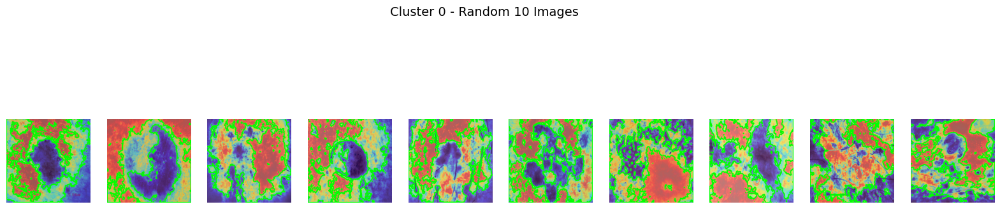

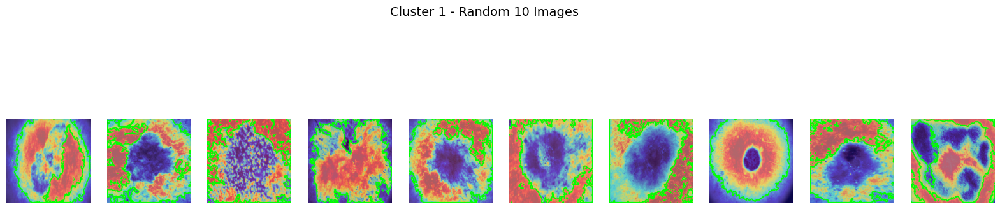

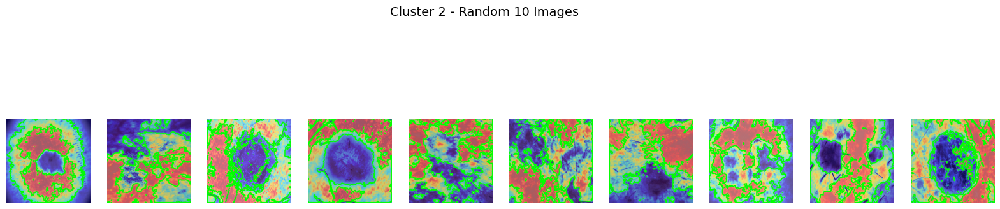

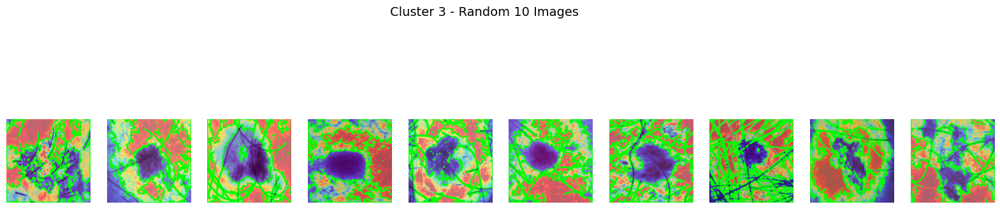

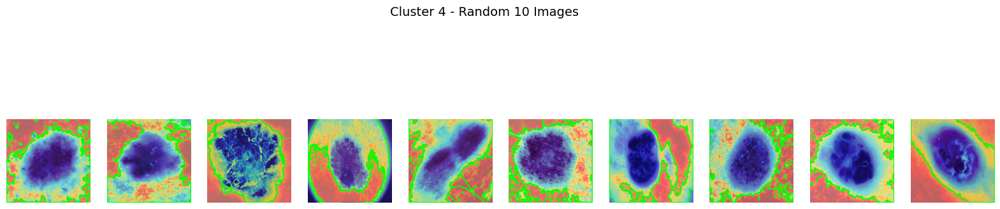

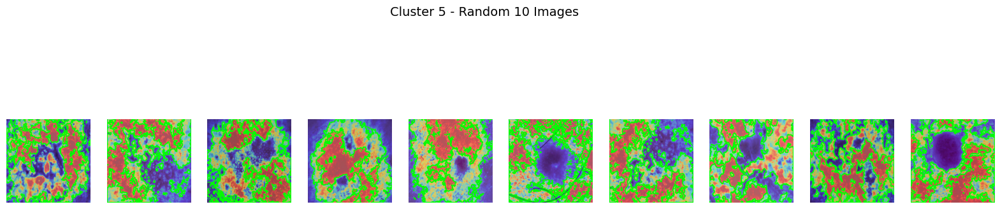

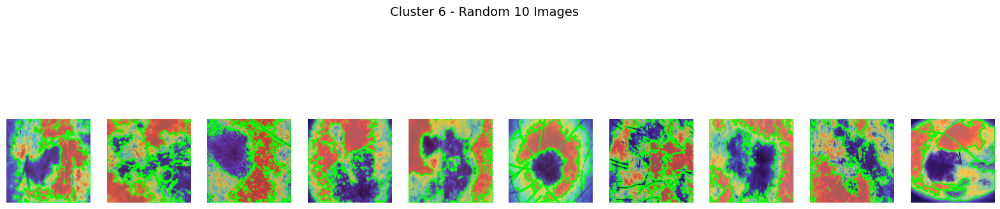

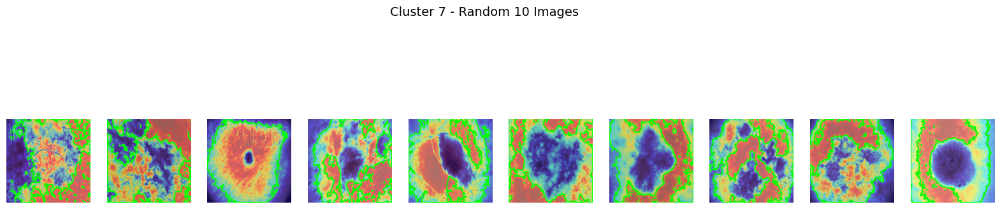

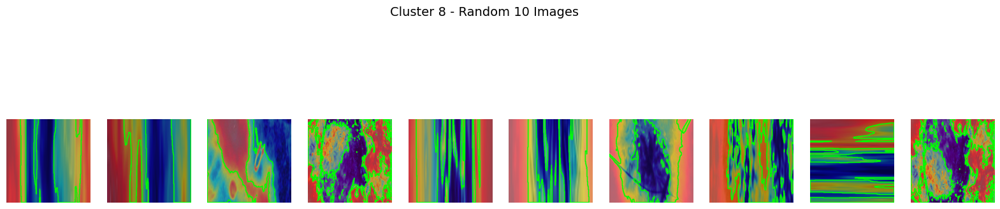

16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
168/168 ━━━━━━━━━━━━━━━━━━━━ 16s 60ms/step
تم استخراج الميزات بنجاح من النموذج المدرب مسبقًا!


In [12]:
import cv2
import numpy as np
import os
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import random
import tensorflow as tf
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.models import Model

# --- التحقق من وجود حدود سوداء ---
def has_black_borders(img, threshold=10):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold
    return not np.all(mask)

# --- إزالة الحدود السوداء ---
def zoom_until_no_borders(img, zoom_step=10):
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step

        if x_min >= x_max or y_min >= y_max:
            break  # لمنع تصغير الصورة بشكل زائد

        img = img[y_min:y_max, x_min:x_max]

    return img

# --- تحميل ومعالجة الصورة ---
def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    image = cv2.imread(image_path)
    
    # إزالة الحدود السوداء
    if has_black_borders(image):
        image = zoom_until_no_borders(image)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)
    
    return color_resized, gray_resized

# --- تطبيق العتبة الرمادية ---
def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

# --- اكتشاف ورسم المحيطات ---
def find_and_draw_contours(image, mask):
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    total_area = sum(cv2.contourArea(c) for c in contours)

    return total_area, contours

# --- دمج الصورة الرمادية مع الصورة الملونة ---
def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

# --- استخراج الخصائص ---
def extract_features(image, contours):
    features = []
    if contours:
        c = max(contours, key=cv2.contourArea)
        area = cv2.contourArea(c)
        perimeter = cv2.arcLength(c, True)
        x, y, w, h = cv2.boundingRect(c)
        diameter = max(w, h)
    else:
        area, perimeter, diameter = 0, 0, 0

    features.extend([area, perimeter, diameter])

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    mean_color = np.mean(hsv, axis=(0, 1))
    features.extend(mean_color)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    texture = np.std(gray)
    features.append(texture)

    return features

# --- معالجة الصور واستخراج الخصائص ---
def process_images_and_extract_features(folder_path):
    images = []
    feature_list = []
    labels = []

    for subdir, _, files in os.walk(folder_path):
        label = os.path.basename(subdir)
        for file in tqdm(files, desc=f"Processing {label}"):
            image_path = os.path.join(subdir, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            total_area, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)
            features = extract_features(merged_image, contours)

            feature_list.append(features)
            images.append(merged_image)
            labels.append(label)

    return images, np.array(feature_list), labels

# --- تجميع الصور (Clustering) ---
def cluster_images(features, num_clusters=7):
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    clusters = kmeans.fit_predict(scaled_features)
    return clusters

# --- عرض الصور في كل Cluster ---
def visualize_clusters(images, clusters, num_images=10):
    clustered_images = {i: [] for i in range(max(clusters) + 1)}

    for i, image in enumerate(images):
        clustered_images[clusters[i]].append(image)

    for cluster_id, img_list in clustered_images.items():
        if img_list:
            selected_images = random.sample(img_list, min(num_images, len(img_list)))
            plt.figure(figsize=(20, 5))
            for i, img in enumerate(selected_images):
                plt.subplot(1, num_images, i + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                plt.axis('off')
            plt.suptitle(f"Cluster {cluster_id} - Random {len(selected_images)} Images", fontsize=14)
            plt.show()

# --- تحميل نموذج مدرب مسبقًا (EfficientNetB0) ---
def load_pretrained_model():
    base_model = EfficientNetB0(weights="imagenet", include_top=False, pooling="avg")
    model = Model(inputs=base_model.input, outputs=base_model.output)
    return model

# --- تمرير الصور إلى النموذج المدرب مسبقًا ---
def extract_features_from_pretrained_model(images, model):
    processed_images = [cv2.resize(img, (224, 224)) for img in images]
    processed_images = np.array([preprocess_input(img) for img in processed_images])
    
    features = model.predict(processed_images, batch_size=32)
    return features

# --- تشغيل الكود الرئيسي ---
folder_path = "/kaggle/working/Merged_Data/"

# 1️⃣ معالجة الصور واستخراج الخصائص
images, features, labels = process_images_and_extract_features(folder_path)

# 2️⃣ تجميع الصور باستخدام Clustering
clusters = cluster_images(features, num_clusters=9)  # 9 لأن لديك 9 فئات
visualize_clusters(images, clusters)

# 3️⃣ تحميل نموذج مدرب مسبقًا
pretrained_model = load_pretrained_model()

# 4️⃣ استخراج الميزات باستخدام النموذج المدرب مسبقًا
deep_features = extract_features_from_pretrained_model(images, pretrained_model)

print("تم استخراج الميزات بنجاح من النموذج المدرب مسبقًا!")


# Clustering

In [13]:
import cv2
import numpy as np
import os
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import random

def has_black_borders(img, threshold=10):
    """التحقق مما إذا كانت الصورة تحتوي على حدود سوداء."""
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold  # تحديد المناطق غير السوداء
    return not np.all(mask)  # ترجع True إذا كانت هناك حدود سوداء

def zoom_until_no_borders(img, zoom_step=10):
    """قص الصورة تدريجياً حتى تختفي الحدود السوداء."""
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step

        if x_min >= x_max or y_min >= y_max:
            break  # إذا أصبحت الصورة صغيرة جدًا، توقف

        img = img[y_min:y_max, x_min:x_max]

    return img

def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    """تحميل الصورة، إزالة الحدود السوداء إن وجدت، وتحسين التباين."""
    image = cv2.imread(image_path)
    
    # إزالة الحدود السوداء إن وجدت
    if has_black_borders(image):
        image = zoom_until_no_borders(image)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)
    
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    """إنشاء قناع لتحديد المناطق الرمادية."""
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    """البحث عن المحيطات ورسمها على الصورة."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)
        area = cv2.contourArea(contour)
        total_area += area

    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    """دمج الصورة الرمادية مع الصورة الملونة مع رسم المحيطات."""
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

def extract_features(image, contours):
    """استخراج خصائص الصورة مثل المساحة، المحيط، القطر، اللون، والملمس."""
    features = []
    if len(contours) > 0:
        c = max(contours, key=cv2.contourArea)
        area = cv2.contourArea(c)
        perimeter = cv2.arcLength(c, True)
    else:
        area, perimeter = 0, 0
    features.extend([area, perimeter])

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    mean_color = np.mean(hsv, axis=(0, 1))
    features.extend(mean_color)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    texture = np.std(gray)
    features.append(texture)

    if len(contours) > 0:
        x, y, w, h = cv2.boundingRect(c)
        diameter = max(w, h)
    else:
        diameter = 0
    features.append(diameter)

    return features

def process_images_and_extract_features(folder_path):
    """معالجة الصور واستخراج الخصائص مع إزالة الحدود السوداء إن وجدت."""
    images = []
    feature_list = []
    labels = []

    for subdir, _, files in os.walk(folder_path):
        label = os.path.basename(subdir)
        for file in tqdm(files, desc=f"Processing {label}"):
            image_path = os.path.join(subdir, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            _, _, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)
            features = extract_features(merged_image, contours)
            feature_list.append(features)
            images.append(merged_image)
            labels.append(label)

    return images, np.array(feature_list), labels

def cluster_images(features, num_clusters=7):
    """تجميع الصور بناءً على الخصائص المستخرجة."""
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    clusters = kmeans.fit_predict(scaled_features)
    return clusters


def visualize_clusters(images, clusters, num_images=10):
    """عرض الصور الأصلية لكل مجموعة بشكل عشوائي."""
    clustered_images = {i: [] for i in range(max(clusters) + 1)}
    
    for i, image in enumerate(images):
        clustered_images[clusters[i]].append(image)

    for cluster_id, img_list in clustered_images.items():
        if len(img_list) > 0:
            selected_images = random.sample(img_list, min(num_images, len(img_list)))  # اختيار صور عشوائية
            plt.figure(figsize=(20, 5))
            for i, img in enumerate(selected_images):
                plt.subplot(1, num_images, i + 1)
                plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
                plt.axis('off')
            plt.suptitle(f"Cluster {cluster_id} - Random {len(selected_images)} Images", fontsize=14)
            plt.show()


Processing Merged_Data: 0it [00:00, ?it/s]
Processing seborrheic keratosis: 100%|██████████| 560/560 [00:08<00:00, 68.58it/s]
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


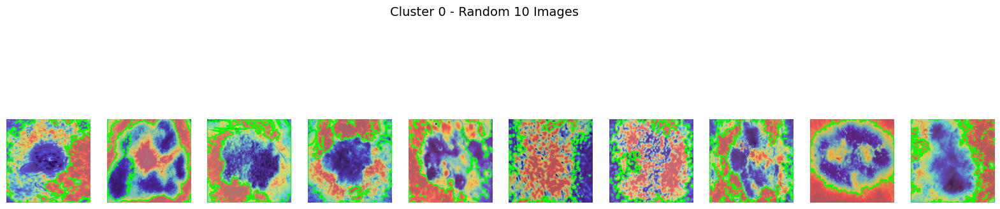

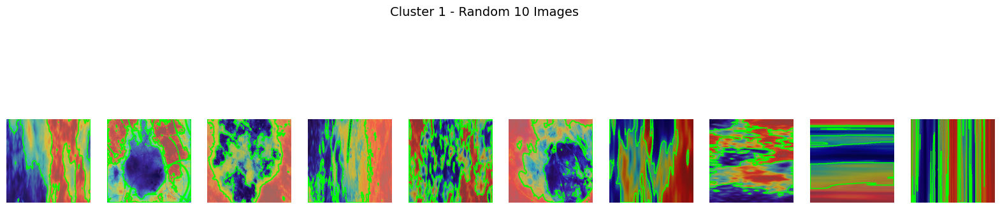

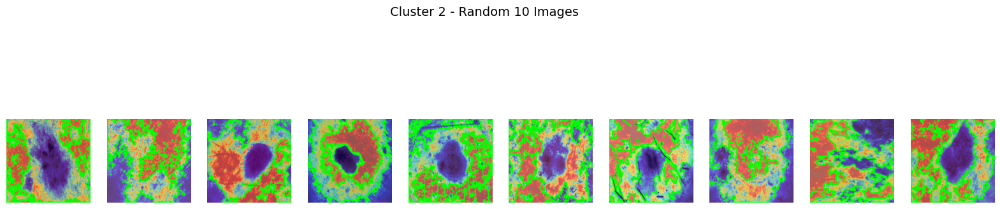

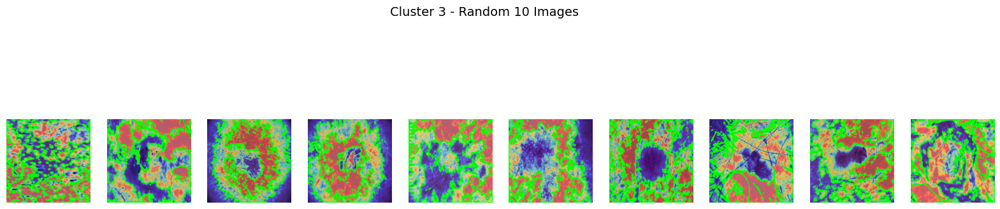

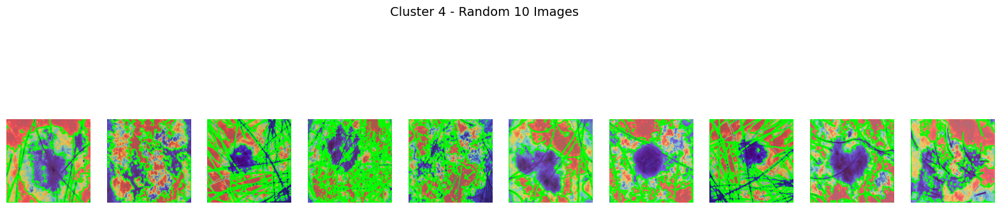

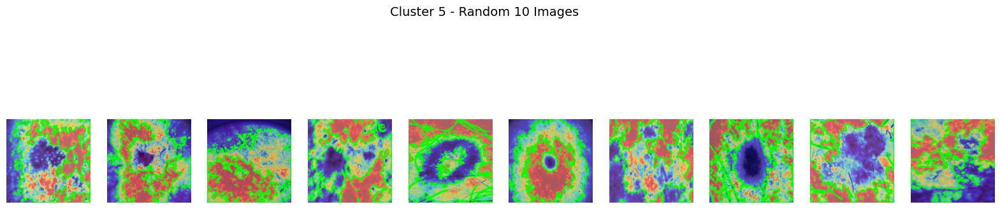

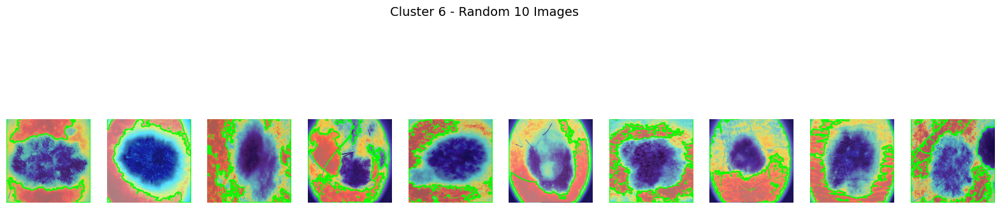

In [14]:
# المسار إلى البيانات
folder_path = "/kaggle/working/Merged_Data"

# معالجة الصور واستخراج الخصائص
images, features, labels = process_images_and_extract_features(folder_path)

# تجميع الصور
clusters = cluster_images(features)
# عرض الصور في الكلاستر
visualize_clusters(images, clusters)

In [15]:
import cv2
import numpy as np
import os
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    """تحميل الصورة وتحويلها إلى اللون الرمادي مع تحسين التباين وتغيير الحجم."""
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    """إنشاء قناع لتحديد المناطق الرمادية."""
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    """البحث عن المحيطات ورسمها على نسخة من الصورة."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)
        area = cv2.contourArea(contour)
        total_area += area

    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    """دمج الصورة الرمادية مع الصورة الملونة ورسم المحيطات على الصورة المدمجة."""
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)

    return merged_image

def extract_features(image, contours):
    """استخراج الخصائص الأساسية للصورة."""
    features = []
    if len(contours) > 0:
        c = max(contours, key=cv2.contourArea)
        area = cv2.contourArea(c)
        perimeter = cv2.arcLength(c, True)
    else:
        area, perimeter = 0, 0
    features.extend([area, perimeter])

    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    mean_color = np.mean(hsv, axis=(0, 1))
    features.extend(mean_color)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    texture = np.std(gray)
    features.append(texture)

    if len(contours) > 0:
        x, y, w, h = cv2.boundingRect(c)
        diameter = max(w, h)
    else:
        diameter = 0
    features.append(diameter)

    return features

def process_images_and_extract_features(folder_path):
    """معالجة الصور واستخراج الخصائص."""
    original_images = []
    merged_images = []
    feature_list = []
    labels = []

    for subdir, _, files in os.walk(folder_path):
        label = os.path.basename(subdir)
        for file in files:
            image_path = os.path.join(subdir, file)
            color_image, gray_image = load_and_preprocess_image(image_path)
            mask = apply_threshold(gray_image)
            _, _, contours = find_and_draw_contours(color_image, mask)
            merged_image = merge_gray_with_color(color_image, gray_image, contours)

            features = extract_features(merged_image, contours)
            feature_list.append(features)
            original_images.append(color_image)
            merged_images.append(merged_image)
            labels.append(label)

    return original_images, merged_images, np.array(feature_list), labels

def cluster_images(features, num_clusters=7):
    """تجميع الصور بناءً على الخصائص المستخرجة."""
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(features)
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    clusters = kmeans.fit_predict(scaled_features)
    return clusters

def visualize_clusters(original_images, merged_images, clusters):
    """عرض الصور الأصلية والدمجية ضمن كل مجموعة."""
    clustered_images = {i: [] for i in range(max(clusters) + 1)}

    for i in range(len(original_images)):
        clustered_images[clusters[i]].append((original_images[i], merged_images[i]))

    for cluster_id, images in clustered_images.items():
        num_images = min(5, len(images))
        if num_images > 0:
            plt.figure(figsize=(20, 10))
            for i in range(num_images):
                original, merged = images[i]
                plt.subplot(2, num_images, i + 1)
                plt.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.title("Original")

                plt.subplot(2, num_images, num_images + i + 1)
                plt.imshow(cv2.cvtColor(merged, cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.title("Merged")

            plt.suptitle(f"Cluster {cluster_id}", fontsize=16)
            plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


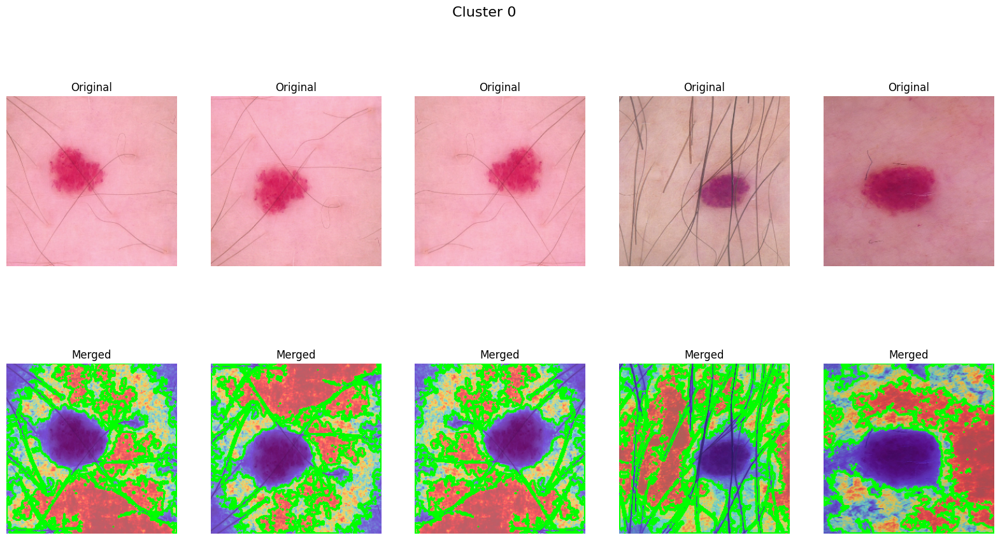

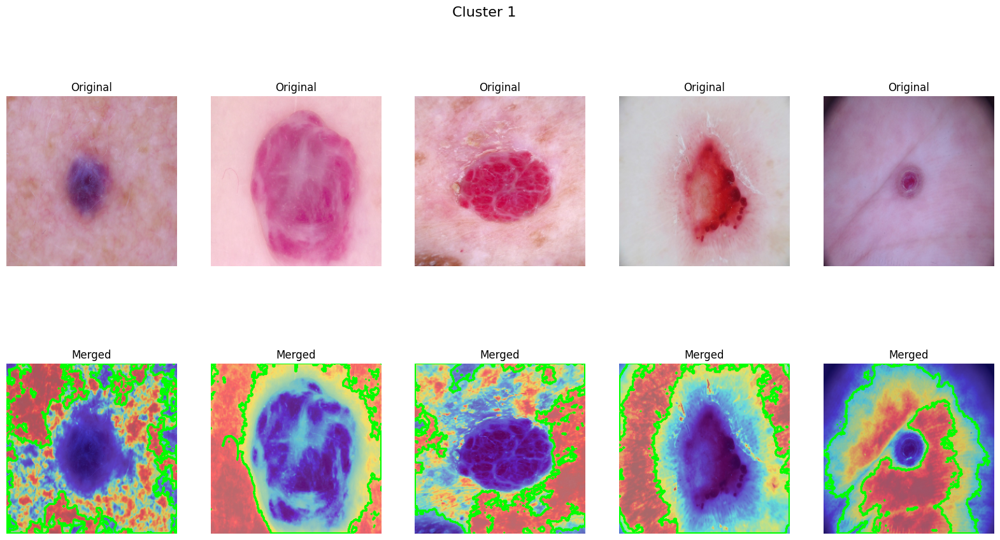

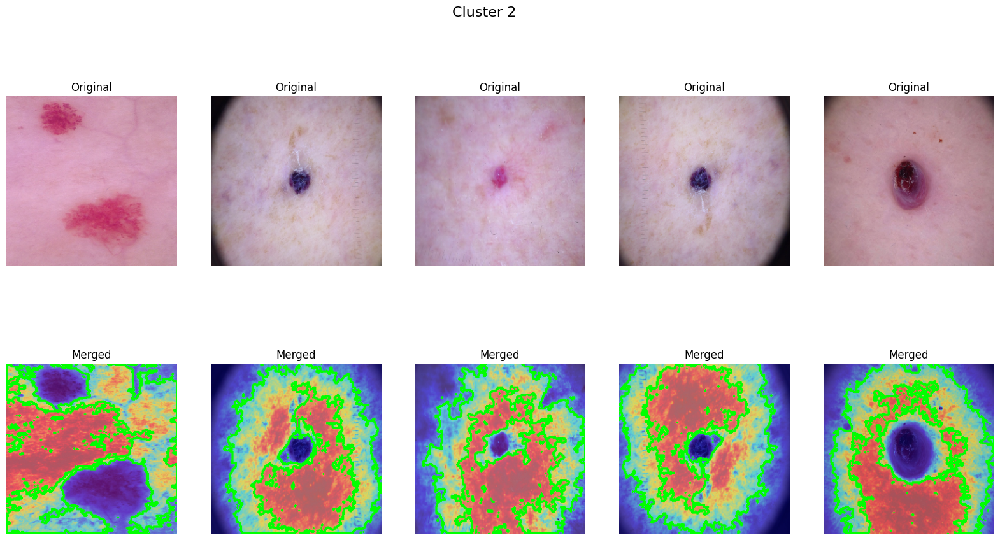

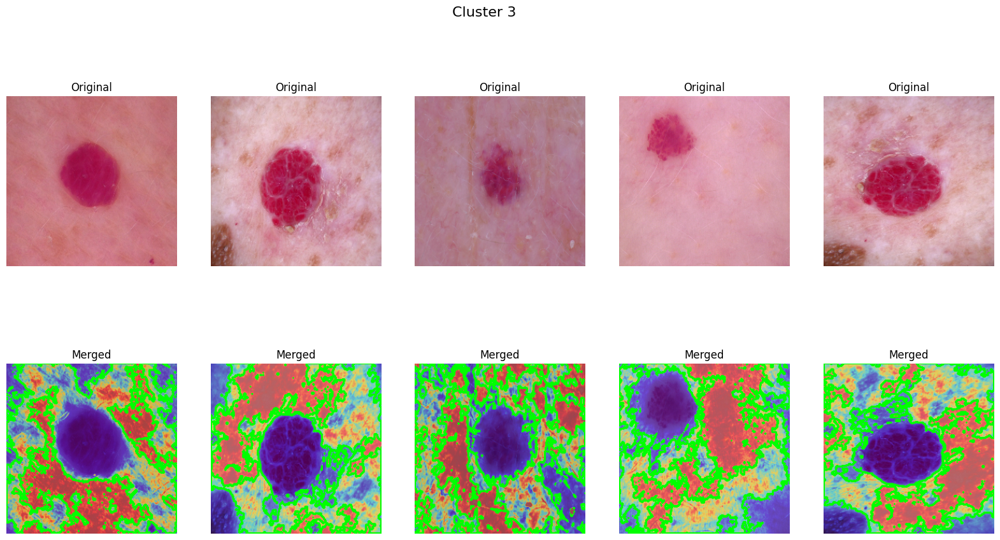

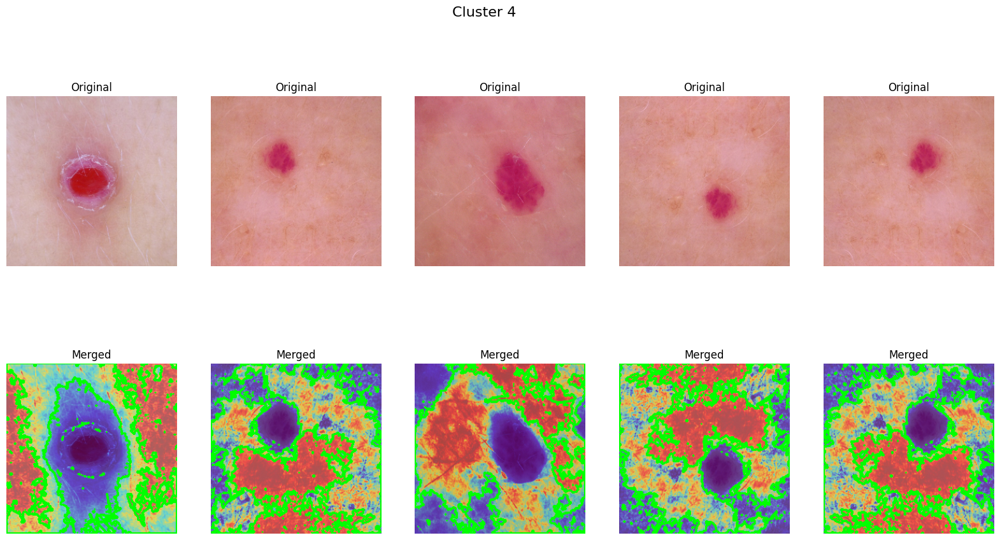

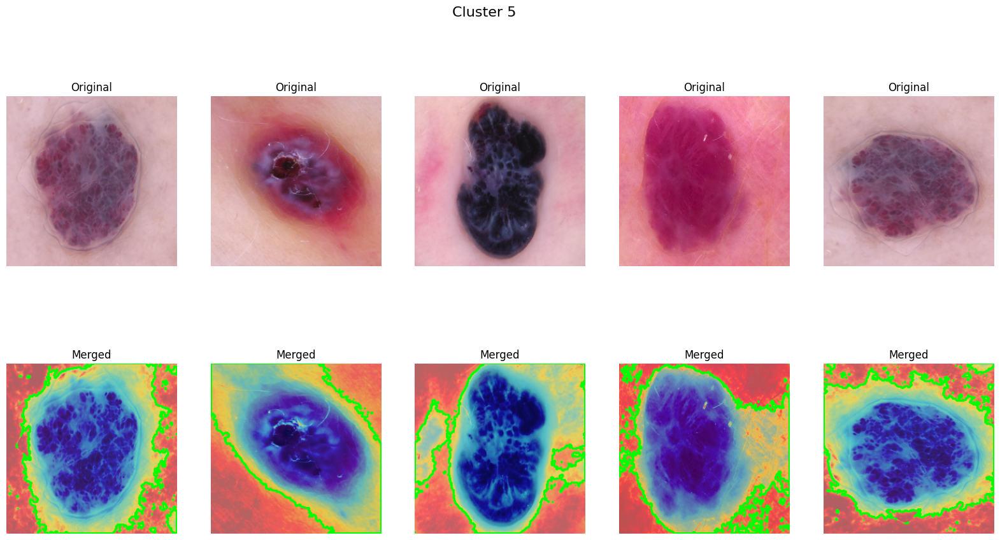

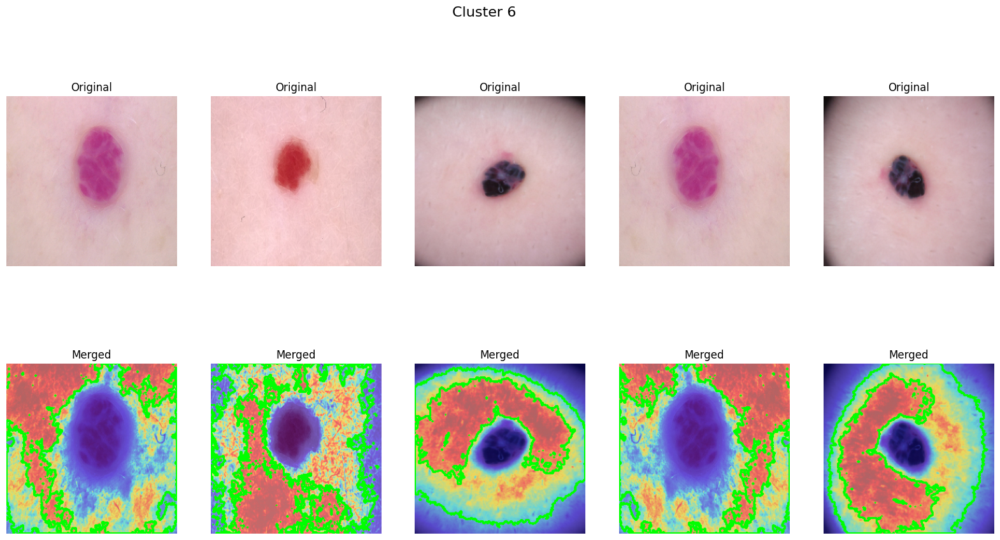

In [16]:
# المسار إلى البيانات
folder_path = "/kaggle/working/Merged_Data"

# معالجة الصور واستخراج الخصائص
original_images, merged_images, features, labels = process_images_and_extract_features(folder_path)

# تجميع الصور
clusters = cluster_images(features)

# عرض الصور الأصلية والمُدمجة
visualize_clusters(original_images, merged_images, clusters)

Actinc Keratosis
Total Gray Area: 43914.5 pixels


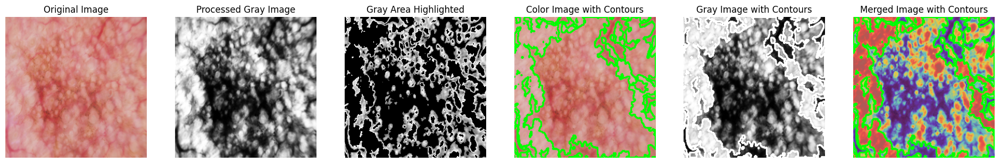

Total Gray Area: 29470.5 pixels


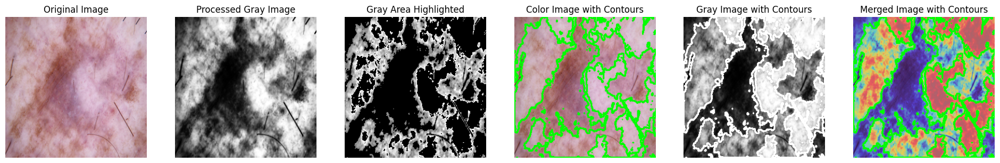

basal cell carcinoma
Total Gray Area: 32646.5 pixels


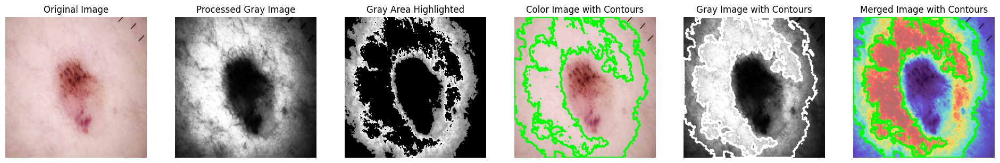

Total Gray Area: 29866.5 pixels


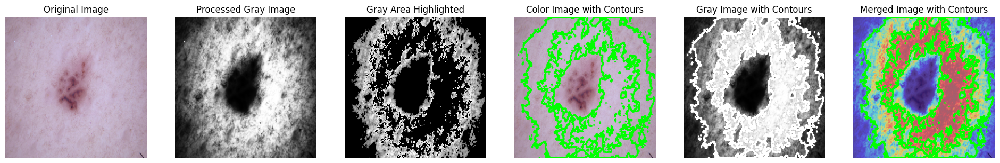

dermatofibroma
Total Gray Area: 25504.0 pixels


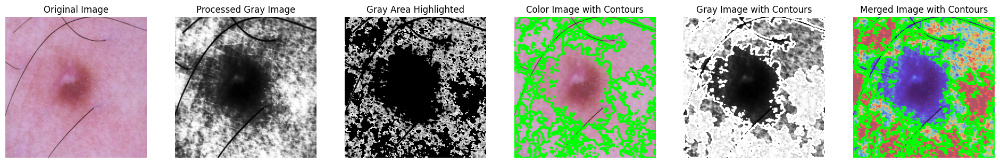

Total Gray Area: 45914.0 pixels


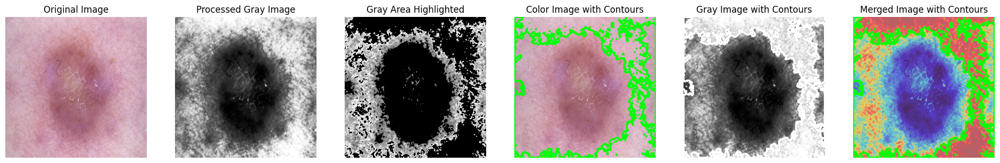

melanoma
Total Gray Area: 45224.5 pixels


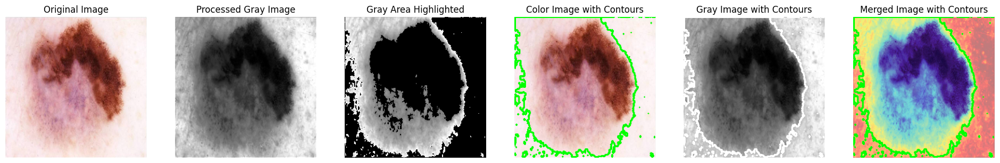

Total Gray Area: 41285.5 pixels


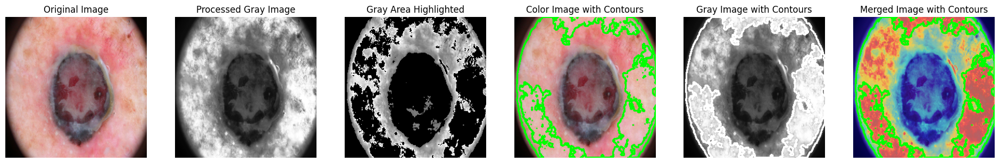

nevus
Total Gray Area: 41967.5 pixels


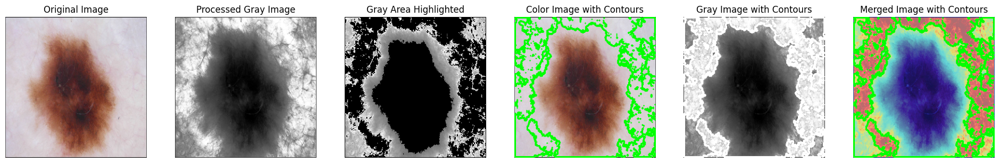

Total Gray Area: 24130.0 pixels


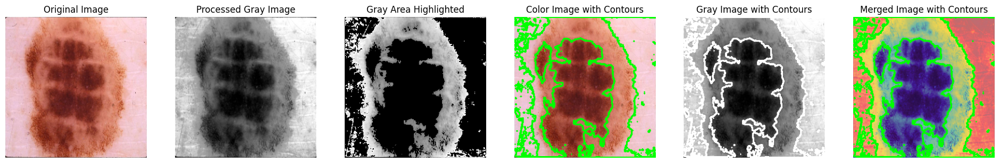

pigmented benign keratosis
Total Gray Area: 44934.0 pixels


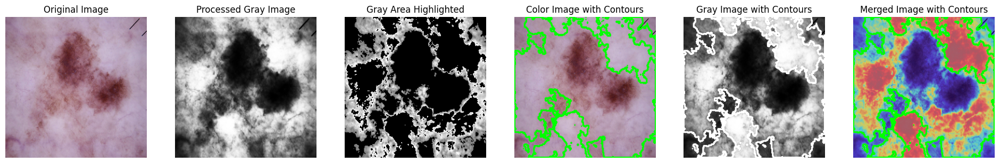

Total Gray Area: 43029.0 pixels


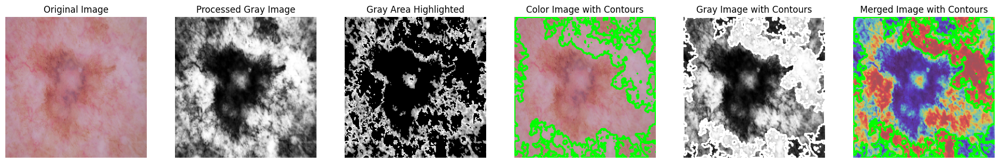

serbirrheic kertosis
Total Gray Area: 45956.5 pixels


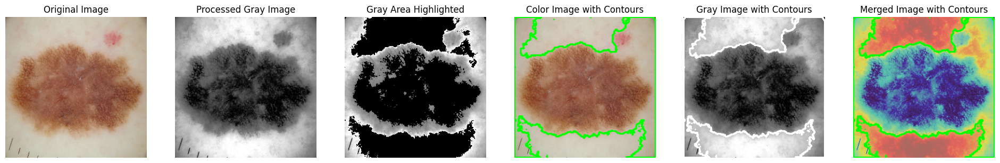

Total Gray Area: 24975.0 pixels


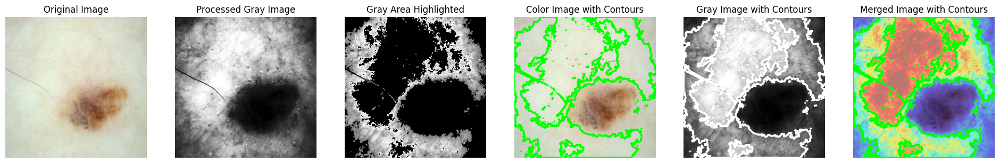

squamous cell carcinma
Total Gray Area: 24109.0 pixels


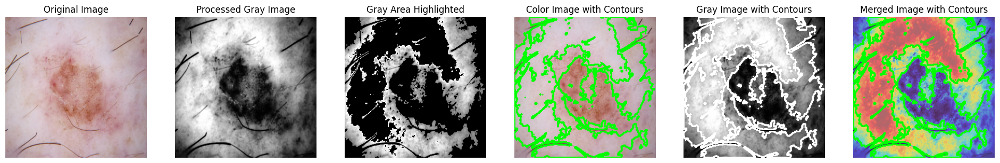

Total Gray Area: 26991.5 pixels


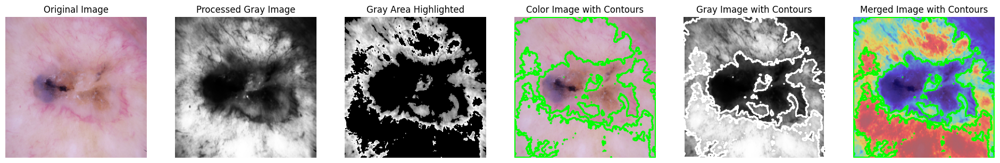

vascular lesion
Total Gray Area: 37746.5 pixels


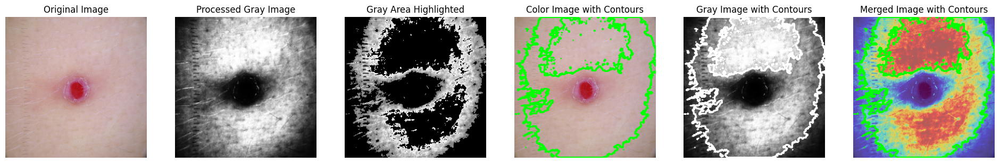

Total Gray Area: 30565.5 pixels


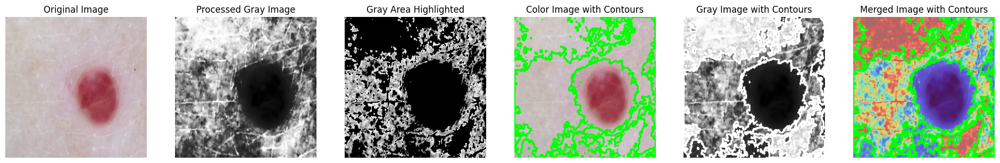

In [17]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_and_preprocess_image(image_path, resize_dim=(256, 256)):
    """تحميل الصورة وتحويلها إلى اللون الرمادي مع تحسين التباين وتغيير الحجم."""
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    equalized = cv2.equalizeHist(blurred)
    gray_resized = cv2.resize(equalized, resize_dim)
    color_resized = cv2.resize(image, resize_dim)
    return color_resized, gray_resized

def apply_threshold(gray_image, lower_gray=80, upper_gray=180):
    """إنشاء قناع لتحديد المناطق الرمادية."""
    mask = cv2.inRange(gray_image, lower_gray, upper_gray)
    return mask

def find_and_draw_contours(image, mask):
    """البحث عن المحيطات ورسمها على نسخة من الصورة."""
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_with_contours = image.copy()
    total_area = 0

    for contour in contours:
        cv2.drawContours(image_with_contours, [contour], -1, (0, 255, 0), 2)  # اللون الأخضر
        area = cv2.contourArea(contour)
        total_area += area

    print(f"Total Gray Area: {total_area} pixels")
    return image_with_contours, total_area, contours

def merge_gray_with_color(color_image, gray_image, contours, alpha=0.5):
    """دمج الصورة الرمادية مع الصورة الملونة ورسم المحيطات على الصورة المدمجة."""
    gray_colormap = cv2.applyColorMap(gray_image, cv2.COLORMAP_JET)
    merged_image = cv2.addWeighted(color_image, 1 - alpha, gray_colormap, alpha, 0)

    # رسم المحيطات على الصورة المدمجة
    for contour in contours:
        cv2.drawContours(merged_image, [contour], -1, (0, 255, 0), 2)  # اللون الأخضر

    return merged_image

def plot_images(image_list, titles):
    """عرض مجموعة من الصور جنبًا إلى جنب."""
    fig, axes = plt.subplots(1, len(image_list), figsize=(24, 5))
    for ax, img, title in zip(axes, image_list, titles):
        if len(img.shape) == 2:  # صورة رمادية
            ax.imshow(img, cmap='gray')
        else:  # صورة ملونة
            ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        ax.set_title(title)
        ax.axis("off")
    plt.show()

def process_and_visualize_image(image_path):
    """الوظيفة الرئيسية لمعالجة الصورة وعرض النتائج."""
    color_resized, gray_resized = load_and_preprocess_image(image_path)

    # تطبيق العتبة وتحديد المناطق الرمادية
    mask = apply_threshold(gray_resized)

    # العثور على المحيطات ورسمها
    color_with_contours, total_gray_area, contours = find_and_draw_contours(color_resized, mask)

    # رسم المحيطات على الصورة الرمادية
    gray_with_contours = gray_resized.copy()
    for contour in contours:
        cv2.drawContours(gray_with_contours, [contour], -1, (255, 255, 255), 2)

    # دمج الصورة الرمادية مع الصورة الملونة ورسم المحيطات
    merged_image = merge_gray_with_color(color_resized, gray_resized, contours)

    # عرض الصور
    plot_images(
        [color_resized, gray_resized, cv2.bitwise_and(gray_resized, gray_resized, mask=mask), 
         color_with_contours, gray_with_contours, merged_image],
        ["Original Image", "Processed Gray Image", "Gray Area Highlighted", 
         "Color Image with Contours", "Gray Image with Contours", "Merged Image with Contours"]
    )

# تجربة الكود على الصور
print("Actinc Keratosis")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0025992.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0026905.jpg")

print("basal cell carcinoma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/basal cell carcinoma/ISIC_0024665.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/basal cell carcinoma/ISIC_0024984.jpg")

print("dermatofibroma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/dermatofibroma/ISIC_0026417.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/dermatofibroma/ISIC_0025771.jpg")

print("melanoma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000166.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000144.jpg")

print("nevus")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/nevus/ISIC_0000063.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/nevus/ISIC_0000224.jpg")

print("pigmented benign keratosis")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/pigmented benign keratosis/ISIC_0025086.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/pigmented benign keratosis/ISIC_0024477.jpg")

print("serbirrheic kertosis")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/seborrheic keratosis/ISIC_0010990.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/seborrheic keratosis/ISIC_0010883.jpg")

print("squamous cell carcinma")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/squamous cell carcinoma/ISIC_0026083.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/squamous cell carcinoma/ISIC_0025471.jpg")

print("vascular lesion")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/ISIC_0024669.jpg")
process_and_visualize_image("/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/vascular lesion/ISIC_0025873.jpg")

# Black area

Black borders found. Zooming in...


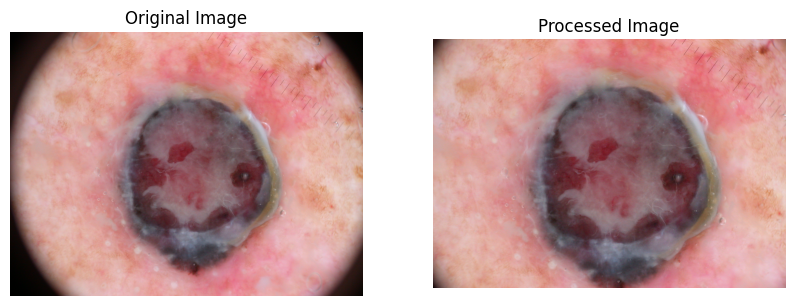

No black borders found. Keeping the original image.


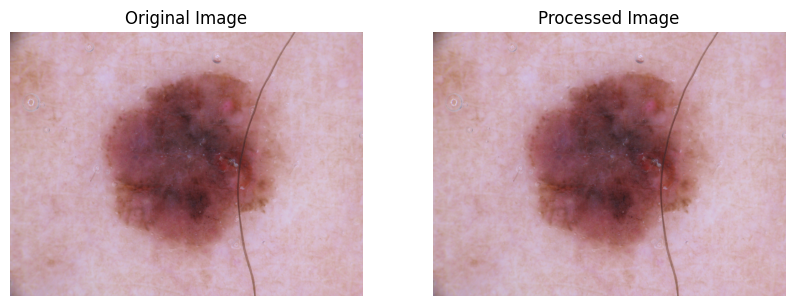

No black borders found. Keeping the original image.


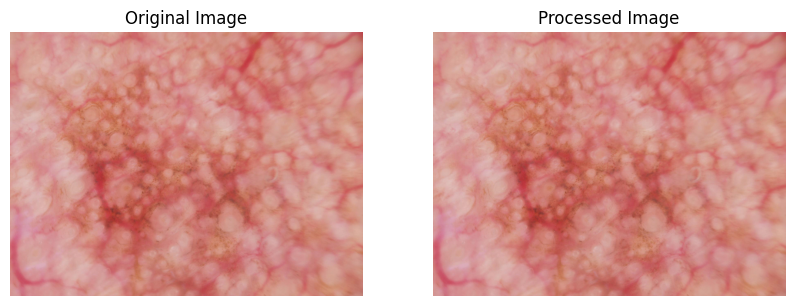

No black borders found. Keeping the original image.


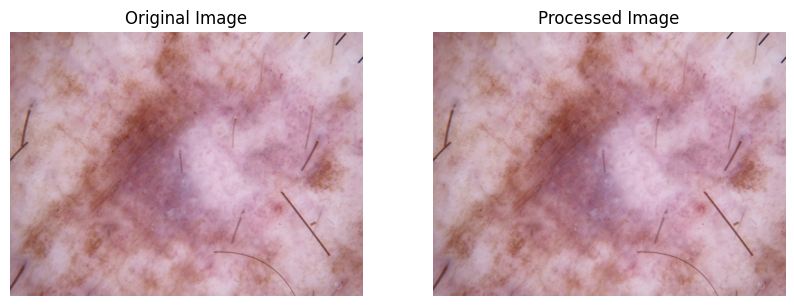

False

In [21]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def has_black_borders(img, threshold=10):
    """Check if the image has black borders."""
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    mask = gray > threshold  # Detect non-black areas
    return not np.all(mask)  # Returns True if borders exist

def zoom_until_no_borders(img, zoom_step=10):
    """Keep zooming in (cropping) until no black borders remain."""
    while has_black_borders(img):
        h, w, _ = img.shape
        x_min, x_max = zoom_step, w - zoom_step
        y_min, y_max = zoom_step, h - zoom_step

        if x_min >= x_max or y_min >= y_max:
            break  # Stop if image becomes too small

        img = img[y_min:y_max, x_min:x_max]

    return img

def process_image(image_path):
    """Load the image, check for black borders, and zoom in if necessary."""
    img = cv2.imread(image_path)

    if has_black_borders(img):
        print("Black borders found. Zooming in...")
        img = zoom_until_no_borders(img)
    else:
        print("No black borders found. Keeping the original image.")

    return img

def show_images_side_by_side(original, processed):
    """Display the original and processed images side by side."""
    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

    # Convert BGR to RGB for correct display
    original_rgb = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)
    processed_rgb = cv2.cvtColor(processed, cv2.COLOR_BGR2RGB)

    axes[0].imshow(original_rgb)
    axes[0].set_title("Original Image")
    axes[0].axis("off")

    axes[1].imshow(processed_rgb)
    axes[1].set_title("Processed Image")
    axes[1].axis("off")

    plt.show()

# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000144.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)

# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/melanoma/ISIC_0000139.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)


# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0025992.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)

# Load and process the image
image_path = "/kaggle/input/skin-cancer9-classesisic/Skin cancer ISIC The International Skin Imaging Collaboration/Train/actinic keratosis/ISIC_0026905.jpg"
original_image = cv2.imread(image_path)
processed_image = process_image(image_path)

# Show the images side by side
show_images_side_by_side(original_image, processed_image)

# Save the processed image
cv2.imwrite("/mnt/data/processed_image.png", processed_image)
